# Loading data from excel files

In [2]:
import os
import glob
import pandas as pd
parent_dir_path=os.path.abspath( os.path.join(os.getcwd(),'..') )
dns_excel_name = pd.ExcelFile(parent_dir_path+'/NSmassData/DNS_mass.xlsx')
nswd_excel_name = pd.ExcelFile(parent_dir_path+'/NSmassData/NSmass_mr_ms.xlsx')
dns_sheet_names=dns_excel_name.sheet_names
nswd_sheet_names=nswd_excel_name.sheet_names
dns_df  = pd.read_excel(dns_excel_name,sheet_name=dns_sheet_names[0]) 
nswd_df  = pd.read_excel(nswd_excel_name,sheet_name=nswd_sheet_names[0]) 
dns_mass_tables=dns_df[['Pname','mr','mrerr','ms','mserr','P0','P1','Pb','e0','yn','pmra','pmdec','gl','gb','dl']]
nswd_mass_tables=nswd_df[[ 'PSRName','mNS','mNSerror','mc','P0','P1','Pb','e','yn','pmra','pmdec','gl','gb','dl' ]]

# There are for pulsars in globular cluster in our work:  J0514-4002A,B2127+11C,J1807-2500B,J1910-5959A. For the P1 of pulsars in globular cluster, the effect including our Galaxy $\dot{P}_{galaxy}$, proper motion $\dot{P}_{proper\_motion}$ and globular cluster potention $\dot{P}_{globular\_cluster}$ (if the PSR is in globular cluster). Where $\dot{P}_{globular\_cluster}$ is the maximum effect, $P_{\rm globular\_cluster} = \frac{a_{\rm globular\_cluster}}{c} \le \frac{3 \sigma_{\rm v}^2}{2(r_{\rm c}^2 + r_{\rm off}^2)^{1/2}}$. The intrinsic $\dot{P}$ is $\dot{P}_{int}=mean(\dot{P}_{obs}-\dot{P}_{galaxy}-\dot{P}_{proper\_motion}±\dot{P}_{globular\_cluster})$. While the intrinsic P1 of these pulsar:J0514-4002A,B2127+11C,J1807-2500B, has been shown in previous works, see citations in our paper. we calculated the instrinsic P1 for  J1910-5959A.

In [3]:
import numpy as np
import astropy.units as units
import astropy.constants as const
# Galactic correction
def p1_galactic(P0, b, l, D, R0):
    """
    calculating the effect of Milky way galaxy
    paramaters:
    _______
    P0: observed period for a PSR
    b,l,D: the location of the PSR
    R0: the radio of Milky way galaxy
    ______
    return : the effect of Milky way galaxy
    """
    R0_D_ratio = R0 / D
    cosb_cosc  = np.cos(b) * np.cos(l)
    coeff      = cosb_cosc + (R0_D_ratio - cosb_cosc) / (1 + R0_D_ratio**2 - 2 * R0_D_ratio * cosb_cosc)
    p1_gal     = -7e-19 * P0 * coeff
    return p1_gal

# Globular cluster's correction
def p1_gc_max(P0, sig_v, radius_c, offset):
    a_gc_max   = 3 * sig_v**2 / (2 * (radius_c ** 2 + (offset * radius_c)**2)**0.5)
    p1_gc_max  = P0 * a_gc_max / const.c
    return p1_gc_max


# NGC 6752 is the host cluster of J1910-5959A

sig_v    = 4.9 * units.km / units.s
size_core= 0.17 * (units.arcmin).to(units.rad)
distance = 4.0 * units.kpc
radius_c = size_core * distance
l, b     = 336.49* units.degree, -25.63 * units.degree

# Solar Galactocentric distance
R0 = 8.3 * units.kpc

# 1910-5959A

p0 = 0.00326618 * units.s
p1_obs = 2.94703e-21

# max effect from gc
p1_gc = p1_gc_max(p0, sig_v, radius_c, 6.39 / 0.17)
#print(p1_gc.decompose())


# galactic correction
p1_gal = p1_galactic(p0, b, l, distance, R0) / units.s
#print(p1_gal)


# proper motion
p1_pm = (5 * units.mas / units.yr)**2 * distance / const.c * p0

if ( p1_obs - p1_gc - p1_gal - p1_pm / units.rad**2 ) > 0:
    p1J1910_5959A=( 0.5*(p1_obs + p1_gc - p1_gal - p1_pm / units.rad**2) + 0.5*(p1_obs - p1_gc - p1_gal - p1_pm / units.rad**2) )
else: p1J1910_5959A = ( 0.5*(p1_obs + p1_gc - p1_gal - p1_pm / units.rad**2) + 0 )

In [4]:
'the observed p1 is',p1_obs, 'the upper limit is',(p1_obs + p1_gc - p1_gal - p1_pm / units.rad**2), 'the lower limit is',( p1_obs - p1_gc - p1_gal - p1_pm / units.rad**2 ),\
'the intrinsic p1 is', p1J1910_5959A

('the observed p1 is',
 2.94703e-21,
 'the upper limit is',
 <Quantity 7.2759432e-21>,
 'the lower limit is',
 <Quantity 3.85660799e-21>,
 'the intrinsic p1 is',
 <Quantity 5.56627559e-21>)

# calculating $\dot{P}_{int}$  using GalDynPsr no considering Globular cluster potential. The package is from: Pathak, D., & Bagchi, M. 2018, ApJ, 868. If the P1_int have been calculated in previous works, we mark as 1(0 for no) in "yn" column in tables.

In [5]:
#for dns in psr
import GalDynPsr 
import numpy as np

for i in range(12):
    if dns_mass_tables['yn'][i]==0:
        dns_rec_expl=GalDynPsr.modelA.Expl(dns_mass_tables['gl'][i], 0, dns_mass_tables['gb'][i], 0, dns_mass_tables['dl'][i], 0)
        dns_rec_exz=GalDynPsr.modelA.Exz(dns_mass_tables['gl'][i], 0, dns_mass_tables['gb'][i], 0, dns_mass_tables['dl'][i], 0)
        dns_rec_shk=GalDynPsr.Shk.Exshk(dns_mass_tables['dl'][i], 0,dns_mass_tables['pmra'][i],0,dns_mass_tables['pmdec'][i],0) 
        dns_mass_tables.at[i,'P1'] = GalDynPsr.pdotint.Pdotint(dns_rec_expl,dns_rec_exz,dns_rec_shk,dns_mass_tables['P1'][i],dns_mass_tables['P0'][i])

Odering of arguments in all functions in GalDynPsr is very important. Consult the README.md (online) or the README.txt file residing in the installation directory
/home/yzq/miniconda3/envs/ns_mass_test/lib/python3.8/site-packages/galpy/util/bovy_conversion.py:8: FutureWarning: galpy.util.bovy_conversion is being deprecated in favor of galpy.util.conversion; all functions in there are the same; please switch to the new import, because the old import will be removed in v1.9
  warnings.warn('galpy.util.bovy_conversion is being deprecated in favor of galpy.util.conversion; all functions in there are the same; please switch to the new import, because the old import will be removed in v1.9',FutureWarning)



In [6]:
dns_mass_tables

,Pname,mr,mrerr,ms,mserr,P0,P1,Pb,e0,yn,pmra,pmdec,gl,gb,dl
0,J0514-4002A,1.2500,0.0600,1.2200,0.0600,0.004991,8.400000e-20,18.785179,0.887977,7.900000e-21,5.190,-0.560,244.514,-35.036,12.1000
1,J1829+2456,1.3060,0.0040,1.2990,0.0040,0.041010,4.350000e-20,1.176028,0.139141,1.000000e+00,0.000,0.000,53.343,15.612,0.9150
2,B1534+12,1.3330,0.0002,1.3455,0.0002,0.037904,2.364362e-18,0.420737,0.273678,0.000000e+00,1.482,-25.285,19.848,48.341,1.0510
3,J0737-3039A,1.3381,0.0007,1.2489,0.0007,0.022699,1.760550e-18,0.102252,0.087777,0.000000e+00,0.000,0.000,245.236,-4.505,0.5200
4,J0509+3801,1.3400,0.0800,1.4600,0.0800,0.076541,7.923556e-18,0.379584,0.586400,0.000000e+00,0.000,0.000,168.275,-1.187,1.5620
5,J1757-1854,1.3406,0.0005,1.3922,0.0005,0.021497,2.653844e-18,0.183538,0.605814,0.000000e+00,0.000,0.000,9.966,2.877,19.5590
6,J1756-2251,1.3410,0.0070,1.2300,0.0070,0.028462,1.015396e-18,0.319634,0.180569,0.000000e+00,-2.420,0.000,6.499,0.948,0.7300
7,B2127+11C,1.3580,0.0100,1.3540,0.0100,0.030529,5.010000e-18,0.335282,0.681395,5.010000e-18,-1.300,-3.300,65.030,-27.315,10.4000
8,J1807-2500B,1.3655,0.0021,1.2064,0.0021,0.004186,1.125000e-19,9.956668,0.747033,2.250000e-19,0.000,0.000,5.830,-2.200,2.8973
9,B1913+16,1.4398,0.0002,1.3886,0.0002,0.059030,8.644919e-18,0.322997,0.617133,0.000000e+00,-0.720,-0.030,49.968,2.122,4.1670


In [6]:
for i in range(12):
    if dns_mass_tables['yn'][i]==0:
        dns_rec_expl=GalDynPsr.modelA.Expl(dns_mass_tables['gl'][i], 0, dns_mass_tables['gb'][i], 0, dns_mass_tables['dl'][i], 0)
        dns_rec_exz=GalDynPsr.modelA.Exz(dns_mass_tables['gl'][i], 0, dns_mass_tables['gb'][i], 0, dns_mass_tables['dl'][i], 0)
        dns_rec_shk=GalDynPsr.Shk.Exshk(dns_mass_tables['dl'][i], 0,dns_mass_tables['pmra'][i],0,dns_mass_tables['pmdec'][i],0) 
        dns_mass_tables.at[i,'P1'] = GalDynPsr.pdotint.Pdotint(dns_rec_expl,dns_rec_exz,dns_rec_shk,dns_mass_tables['P1'][i],dns_mass_tables['P0'][i])

In [7]:
for i in range(27):
    if nswd_mass_tables['yn'][i]==0:
        nswd_rec_expl=GalDynPsr.modelA.Expl(nswd_mass_tables['gl'][i], 0, nswd_mass_tables['gb'][i], 0, nswd_mass_tables['dl'][i], 0)
        nswd_rec_exz=GalDynPsr.modelA.Exz(nswd_mass_tables['gl'][i], 0, nswd_mass_tables['gb'][i], 0, nswd_mass_tables['dl'][i], 0)
        nswd_rec_shk=GalDynPsr.Shk.Exshk(nswd_mass_tables['dl'][i], 0,nswd_mass_tables['pmra'][i],0,nswd_mass_tables['pmdec'][i],0) 
        nswd_mass_tables.at[i,'P1'] = GalDynPsr.pdotint.Pdotint(nswd_rec_expl,nswd_rec_exz,nswd_rec_shk,nswd_mass_tables['P1'][i],nswd_mass_tables['P0'][i])

In [8]:
nswd_mass_tables

,PSRName,mNS,mNSerror,mc,P0,P1,Pb,e,yn,pmra,pmdec,gl,gb,dl
0,J1802-2124,1.2400,0.1100,0.7800,0.012648,7.117968e-20,0.698889,2.480000e-06,0.000000e+00,-0.850,4.800,8.382,0.611,0.760
1,J2045+3633,1.2510,0.0210,0.8730,0.031682,5.953000e-19,32.297845,1.721244e-02,1.000000e+00,-3.200,-2.680,77.832,-3.926,5.629
2,J1918-0642,1.2900,0.1000,0.2310,0.007646,2.369916e-20,10.913178,2.034200e-05,0.000000e+00,-7.149,-5.972,30.027,-9.123,1.111
3,J1910-5959A,1.3300,0.1100,0.1800,0.003266,5.566000e-21,0.837113,3.400000e-06,7.275900e-21,-3.080,-3.970,336.525,-25.730,4.000
4,J1949+3106,1.3400,0.1700,0.8100,0.013138,9.400000e-20,1.949535,4.306000e-05,1.000000e+00,-2.894,-5.093,66.858,2.554,7.468
5,J1713+0747,1.3500,0.0700,0.2920,0.004570,8.144245e-21,67.825130,7.494040e-05,0.000000e+00,4.915,-3.914,28.751,25.223,1.149
6,J2234+0611,1.3530,0.0170,0.2980,0.003577,6.470000e-21,32.001402,1.292740e-01,1.000000e+00,25.300,9.710,72.991,-43.006,0.971
7,J2043+1711,1.3800,0.1300,0.1730,0.002380,4.195407e-21,1.482291,4.870000e-06,0.000000e+00,-5.722,-10.831,61.919,-15.313,1.562
8,J2053+4650,1.4000,0.2100,0.8600,0.012586,1.660000e-19,2.452499,8.900000e-06,1.000000e+00,-0.961,-6.969,344.090,16.451,1.887
9,J0337+1715,1.4359,0.0003,0.1973,0.002733,1.729300e-20,1.629402,6.917800e-04,1.000000e+00,4.810,-4.420,169.990,-30.039,1.300


# 2. calculate $t_c$, $P_{birth}^{min}$,$\dot{P}_{birth}$ and slove the intersection of stable accretion

In [7]:
import astropy
import astropy.units as u 

def pdot_mag(p,B_mag):
    """
    get Pdot for a constant magnetic field 
    paramaters:
    -------
    p: the period, uni, s
    B_mag: the value of constant magnetic field, unit: G 
    -------
    return:
    p_dot
    
    """
    return (B_mag / 3.2e19)**2 / p
    

def pdot_year(p,year):
    """
    get Pdot for a constant age
    paramaters:
    -------
    p: the period, uni, s
    year: the value of the constant age, unit: yr
    -------
    return:
    p_dot
    
    """
    return 0.5*p/(year*365*24*60*60)

def t_c(p,pdot):
    """
    callculate the characteristic age given p and pdot
    paramaters:
    -----
    p,pdot: i.e. period and period derivative; units= s , none
    return :
    the characteristic age; unit = Gyr
    
    """
    return (p/(2*pdot))*u.s.to(u.Gyr) #unit Gyr

def p_pdot_forb(p):
    
    """
    spin-up line
    paramaters:
    -----
    p: period ,unit: s
    return: p_dot
    """
    return 1.1*10**(-15)*p**(4/3)

def p_pdot_forb_liu(p):
    
    """
    spin-up line
    paramaters:
    -----
    p: period ,unit: s
    return: p_dot
    """
    return 3.76*10**(-15)*p**(4/3)

def p_mid_sol(p,p_dot):
    """
    slove the intersection of two lines between the spin-up line and constatnt magnetic field lines to get period
    paramaters:
    ------
    input: p, p_dot, i.e. intrinsic period and period derivative
    return: 
    p_intsect, i.e. the period at the intersection between the spin-up line and the evolution trace of constant magnetic field
    """
    return (p_dot * p / ((1.1)*10**(-15)))**(3/7) ##mid 0 up +0.5 ##low -0.5

def p_dot_mid_sol(p,p_dot):
    """
    slove the intersection of two lines between the spin-up line and constatnt magnetic field lines to get pdot
    paramaters:
    ------
    input: p, p_dot, i.e. intrinsic period and period derivative
    return: 
    p_dot_intsect, i.e. the period derivative at the intersection between the spin-up line and the evolution trace of constant magnetic field
    """
    return ( (p_dot * p / ((1.1)*10**(-15)))**(4/7) ) * (1.1)*10**(-15)

def t_bet(p,pdot,p0):#time from (p_birth pdot_birth) to (p pdot)_obs
    return (p/(2*pdot) *(1-(p0/p)**2) )*u.s.to(u.Gyr)

In [8]:
# Case: Double NS
tc_dnss=np.zeros(13)
for i in range(12):
    tc_dnss[i]=t_c(dns_mass_tables['P0'][i],dns_mass_tables['P1'][i])
tc_dns=pd.DataFrame(tc_dnss,columns=['tc'])
dns_mass_tables=pd.concat([dns_mass_tables,tc_dns],axis=1)

In [9]:
# Case: NS-WD

tc_nswds=np.zeros(41)
for i in range(27):
    tc_nswds[i]=t_c(nswd_mass_tables['P0'][i],nswd_mass_tables['P1'][i])
tc_nswd=pd.DataFrame(tc_nswds,columns=['tc'])
nswd_mass_tables=pd.concat([nswd_mass_tables,tc_nswd],axis=1)


## (1) Get p and pdot on the spin-up line

In [10]:
# (1) Get p and pdot on the spin-up line

birth_dns=np.zeros((13,2))
birth_dns[:,0]=p_mid_sol(dns_mass_tables['P0'], dns_mass_tables['P1'])
birth_dns[:,1]=p_dot_mid_sol(dns_mass_tables['P0'], dns_mass_tables['P1'])

birth_nswd=np.zeros((41,2))
birth_nswd[:,0]=p_mid_sol( nswd_mass_tables['P0'], nswd_mass_tables['P1'] )
birth_nswd[:,1]=p_dot_mid_sol( nswd_mass_tables['P0'], nswd_mass_tables['P1'] )

## (2) Set minimum p = 1 ms, re-compute its Pdot

In [11]:
# Set minimum p = 1 ms, re-compute its Pdot

for i in range(len(birth_nswd)):
    if birth_nswd[i,0]<0.001:
        birth_nswd[i,0]=0.001 #p0
        birth_nswd[i,1]=nswd_mass_tables['P0'][i]* nswd_mass_tables['P1'][i]/0.001 #p1

for i in range(len(birth_dns)):
    if birth_dns[i,0]<0.001:
        birth_dns[i,0]=0.001 #p0
        birth_dns[i,1]=dns_mass_tables['P0'][i]* dns_mass_tables['P1'][i]/0.001 #p1
       

In [12]:
birth_nswd_data=pd.DataFrame(birth_nswd,columns=['p0_birth','p1_birth'])
birth_dns_data=pd.DataFrame(birth_dns,columns=['p0_birth','p1_birth'])
nswd_mass_tables=(pd.concat([nswd_mass_tables,birth_nswd_data.reset_index(drop=True)],axis=1)).reset_index(drop=True)
dns_mass_tables =(pd.concat([dns_mass_tables,birth_dns_data.reset_index(drop=True)],axis=1)).reset_index(drop=True)

In [13]:
# Characteristic age at 'minimum' birth period

tc_b_nswd=t_c(nswd_mass_tables['p0_birth'],nswd_mass_tables['p1_birth'])
tc_b_dns =t_c(dns_mass_tables['p0_birth'],dns_mass_tables['p1_birth'])

tc_b_nswds=pd.DataFrame(tc_b_nswd,columns=['tc_b'])
tc_b_dnss=pd.DataFrame(tc_b_dns,columns=['tc_b'])
nswd_mass_tables=pd.concat([nswd_mass_tables,tc_b_nswds],axis=1)
dns_mass_tables =pd.concat([dns_mass_tables,tc_b_dnss],axis=1)

## (3) calculating maximum age: $t_{\rm max} = t_{c, {\rm int}} - t_{c, {\rm minimum}} < 11Gyr$ 

In [14]:
tmax_nswd=(nswd_mass_tables['tc']-nswd_mass_tables['tc_b'])
tmax_dns=(dns_mass_tables['tc']-dns_mass_tables['tc_b'])

# set maximum age = 11 Gyr
for i in range(len(tmax_nswd)):
    if tmax_nswd[i]>11: #the age of milky way 11 Gyr
        tmax_nswd[i]=11
tmax_nswds=pd.DataFrame(tmax_nswd,columns=['tmax'])

for i in range(len(tmax_dns)):
    if tmax_dns[i]>11: #the age of milky way 11 Gyr
        tmax_dns[i]=11
tmax_dnss=pd.DataFrame(tmax_dns,columns=['tmax'])

nswd_mass_tables=pd.concat([nswd_mass_tables,tmax_nswds],axis=1)
dns_mass_tables =pd.concat([dns_mass_tables,tmax_dnss],axis=1)

In [15]:
# get 'minimum' birth period for given age

def p_birth_lim(p0,p1,tr):
    """
    calculate the minimum birth period  
    paramaters:
    -----
    p0: observed period, unit: s
    p1: intrinsic period derivative, unit: none
    tr: age, unit: s 
    -----
    return: 
    minimum birth period, unit: s 
    
    """
    
    return p0*np.sqrt(1-(2*p1*tr)/p0)

def p1_birth_lim(p0,p1,tr):
    """
    calculate the period derivative corresponding to the minimum birth period 
    paramaters:
    -----
    p0: observed period, unit: s
    p1: intrinsic period derivative, unit: none
    tr: age, unit: s 
    -----
    return: 
    period derivative, unit: none
    
    """
    return p0*p1/p_birth_lim(p0,p1,tr)

In [16]:
p0_lim_nswd=p_birth_lim(nswd_mass_tables['P0'],nswd_mass_tables['P1'],nswd_mass_tables['tmax']*u.Gyr.to(u.s))
p1_lim_nswd=p1_birth_lim(nswd_mass_tables['P0'],nswd_mass_tables['P1'],nswd_mass_tables['tmax']*u.Gyr.to(u.s))
p0_lim_dns=p_birth_lim(dns_mass_tables['P0'],dns_mass_tables['P1'],dns_mass_tables['tmax']*u.Gyr.to(u.s))
p1_lim_dns=p1_birth_lim(dns_mass_tables['P0'],dns_mass_tables['P1'],dns_mass_tables['tmax']*u.Gyr.to(u.s))

p0_lim_nswds=pd.DataFrame(p0_lim_nswd,columns=['p0_birth_lim'])
p1_lim_nswds=pd.DataFrame(p1_lim_nswd,columns=['p1_birth_lim'])
p0_lim_dnss=pd.DataFrame(p0_lim_dns,columns=['p0_birth_lim'])
p1_lim_dnss=pd.DataFrame(p1_lim_dns,columns=['p1_birth_lim'])

nswd_mass_tables=pd.concat([nswd_mass_tables,p0_lim_nswds],axis=1)
nswd_mass_tables=pd.concat([nswd_mass_tables,p1_lim_nswds],axis=1)
dns_mass_tables=pd.concat([dns_mass_tables,p0_lim_dnss],axis=1)
dns_mass_tables=pd.concat([dns_mass_tables,p1_lim_dnss],axis=1)

In [17]:
nswd_mcerr=np.zeros(41)
nswd_mcerrs=pd.DataFrame(nswd_mcerr,columns=['mcerr_nswd'])
nswd_mass_tables=pd.concat([nswd_mass_tables,nswd_mcerrs],axis=1)

## combine BNS and NSWD data

In [18]:
dns_mass_tables
labels_nswd = ['PSRName','mNS','mNSerror','mc','mcerr_nswd','P0','P1','yn','pmra','pmdec','gl','gb',
          'dl','tc','p0_birth_lim','p1_birth_lim','tc_b','tmax']
labels_dns= ['Pname','mr','mrerr','ms','mserr','P0','P1','yn','pmra','pmdec','gl','gb',
          'dl','tc','p0_birth_lim','p1_birth_lim','tc_b','tmax'] #main 
rec_dns =dns_mass_tables[labels_dns]
rec_nswd=nswd_mass_tables[labels_nswd]
data_as=(pd.concat([rec_dns,(rec_nswd.rename(columns={'PSRName':'Pname','mNS':'mr','mNSerror':'mrerr','mc':'ms','mcerr_nswd':'mserr'})).reset_index(drop=True)],axis=0,ignore_index=True)).reset_index(drop=True)

In [19]:
p_1_index=np.int64(np.linspace(0,11,12))
p_2_index=np.int64(np.linspace(13,39,27))
mod_index=np.concatenate((p_1_index,p_2_index))
data_a=(data_as.iloc[mod_index,:]).reset_index(drop=True)
data_a

,Pname,mr,mrerr,ms,mserr,P0,P1,yn,pmra,pmdec,gl,gb,dl,tc,p0_birth_lim,p1_birth_lim,tc_b,tmax
0,J0514-4002A,1.2500,0.0600,1.2200,0.0600,0.004991,8.400000e-20,7.900000e-21,5.190,-0.560,244.514,-35.036,12.1000,0.941320,0.001774,2.362729e-19,0.118978,0.822342
1,J1829+2456,1.3060,0.0040,1.2990,0.0040,0.041010,4.350000e-20,1.000000e+00,0.000,0.000,53.343,15.612,0.9150,14.937045,0.021054,8.472985e-20,0.096743,11.000000
2,B1534+12,1.3330,0.0002,1.3455,0.0002,0.037904,2.364362e-18,0.000000e+00,1.482,-25.285,19.848,48.341,1.0510,0.254005,0.017684,5.067896e-18,0.055286,0.198719
3,J0737-3039A,1.3381,0.0007,1.2489,0.0007,0.022699,1.760550e-18,0.000000e+00,0.000,0.000,245.236,-4.505,0.5200,0.204283,0.012510,3.194507e-18,0.062047,0.142236
4,J0509+3801,1.3400,0.0800,1.4600,0.0800,0.076541,7.923556e-18,0.000000e+00,0.000,0.000,168.275,-1.187,1.5620,0.153053,0.040130,1.511294e-17,0.042071,0.110982
5,J1757-1854,1.3406,0.0005,1.3922,0.0005,0.021497,2.653844e-18,0.000000e+00,0.000,0.000,9.966,2.877,19.5590,0.128343,0.014572,3.915112e-18,0.058971,0.069373
6,J1756-2251,1.3410,0.0070,1.2300,0.0070,0.028462,1.015396e-18,0.000000e+00,-2.420,0.000,6.499,0.948,0.7300,0.444109,0.010888,2.654394e-18,0.064988,0.379121
7,B2127+11C,1.3580,0.0100,1.3540,0.0100,0.030529,5.010000e-18,5.010000e-18,-1.300,-3.300,65.030,-27.315,10.4000,0.096548,0.022237,6.878364e-18,0.051221,0.045327
8,J1807-2500B,1.3655,0.0021,1.2064,0.0021,0.004186,1.125000e-19,2.250000e-19,0.000,0.000,5.830,-2.200,2.8973,0.589564,0.001865,2.525190e-19,0.117017,0.472547
9,B1913+16,1.4398,0.0002,1.3886,0.0002,0.059030,8.644919e-18,0.000000e+00,-0.720,-0.030,49.968,2.122,4.1670,0.108188,0.037268,1.369310e-17,0.043122,0.065066


In [32]:
data_a.to_csv('39_mr_all_info.csv')

# 3. p_birth_random from random U (0, tmax)

In [22]:
import astropy
import astropy.units as u 

nu=len(data_a['mr'])
ns=10000
t_u  =np.zeros(nu*ns)
p0_ns=np.zeros(nu*ns)
pdot_int_ns=np.zeros(nu*ns)

for i in range(nu):
    if ((0<data_a['tmax'][i])&(15>data_a['tmax'][i]) ):
        t_u[i*ns:(i+1)*ns]=np.random.uniform(0,(data_a['tmax'][i]),10000)            #unit Gyr
        p0_ns[i*ns:(i+1)*ns]=np.ones(ns)*data_a['P0'][i]                             #unit s
        pdot_int_ns[i*ns:(i+1)*ns]=np.ones(ns)*data_a['P1'][i]                 #unit s*s-1
    else:
        t_u[i*ns:(i+1)*ns]=np.random.uniform(0,0,10000)            #unit Gyr
        p0_ns[i*ns:(i+1)*ns]=np.ones(ns)*data_a['P0'][i]                             #unit s
        pdot_int_ns[i*ns:(i+1)*ns]=np.ones(ns)*data_a['P1'][i]                 #unit s*s-1
t_u=t_u*u.Gyr.to(u.s)  #transfer Gyr to s 

pran=np.zeros(nu*ns)
p1ran=np.zeros(nu*ns)
pran=p_birth_lim(p0_ns,pdot_int_ns,t_u)
p1ran=p1_birth_lim(p0_ns,pdot_int_ns,t_u)

p_birth_mean=np.zeros(nu)
p1_birth_mean=np.zeros(nu)
for i in range(nu):
    p_birth_mean[i]=np.mean(pran[i*ns:(i+1)*ns])
    p1_birth_mean[i]=(data_a['P0'][i]*data_a['P1'][i])/p_birth_mean[i]

In [34]:
np.savetxt('phe_pran.txt',p_birth_mean)

In [35]:
p_birth_err=np.zeros(nu)
for i in range(nu):
    p_birth_err[i]=np.std(pran[i*ns:(i+1)*ns])
np.savetxt('phe_pran_err.txt',p_birth_err)

# $P-\dot{P}$ diagram, $\dot{P}_{\rm obs}$, $\dot{P}_{\rm int}$ and initial period and its derivative 

In [20]:
spin_up_3p7=np.zeros((len(data_a['P0']),2))
for i in range(len(data_a['P0'])):
    if data_a['p1_birth_lim'][i]/(data_a['p0_birth_lim'][i])**(4/3) < 1.099*10**(-15):
        spin_up_3p7[i,0]=data_a['p0_birth_lim'][i]
        spin_up_3p7[i,1]=data_a['p1_birth_lim'][i]

    else:
                spin_up_3p7[i,0]= ( ( data_a['p1_birth_lim'][i] * data_a['p0_birth_lim'][i])/(3.76*10**(-15)) )**(3/7)
                spin_up_3p7[i,1]= (3.76*10**(-15) )**(3/7) * ( ( data_a['p1_birth_lim'][i] * data_a['p0_birth_lim'][i])) **(4/7)
                print( t_bet(data_a['P0'][i],data_a['P1'][i], spin_up_3p7[i,0]) )

for i in range(len(spin_up_3p7[:,0])):
    if spin_up_3p7[i,0] < 0.001 :
        spin_up_3p7[i,0]=0.001
        spin_up_3p7[i,1]=(data_a['p1_birth_lim'][i]*data_a['p0_birth_lim'][i])/0.001

0.899831481174373
0.23472636362596144
0.18264653622870136
0.13838253666332767
0.10777982509907487
0.42144731490968135
0.07868716825957543
0.5487596098958203
0.09315084230527114
4.0709548694122715
2.4337778632435616
2.724605775652684
0.8191331252292199
4.669017270427344
2.1789342529038302
1.1683283311993498
1.549279343325921
3.7943761990938554
0.16752794925015788
2.5481106130511355


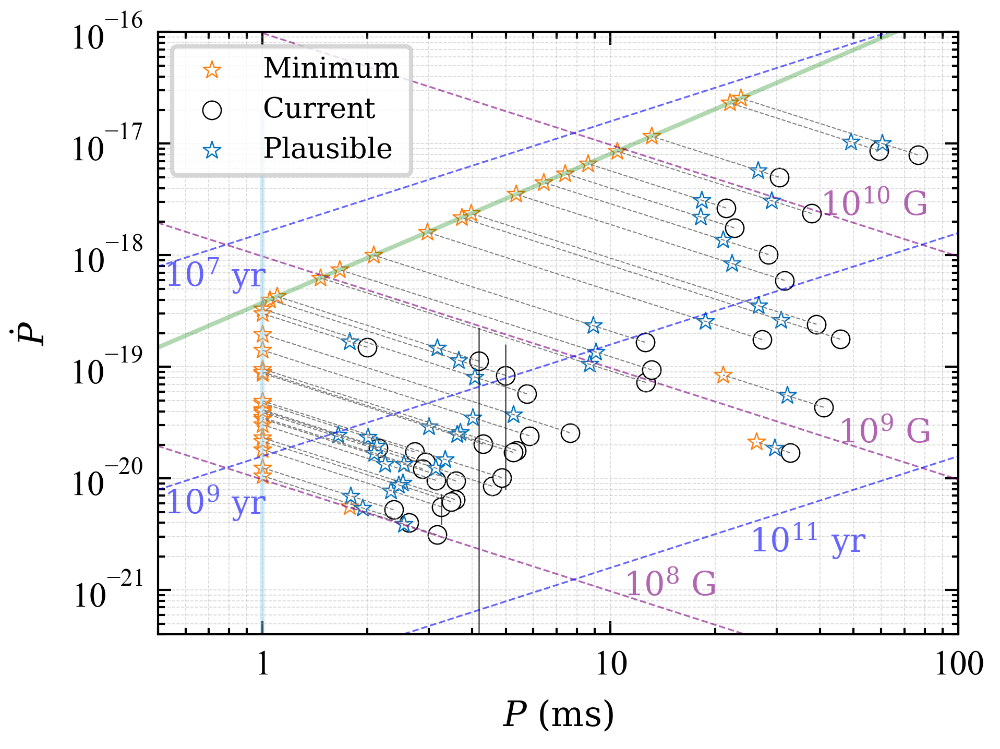

In [23]:
import numpy as np
import pandas as pd
#p_birth_mean=data_a['p1_birth_lim']
spin_up_liu_min=spin_up_3p7
#data_a=pd.read_csv('data_combined.csv')

err_gc=np.zeros(39)
err_gc[0] =abs(data_a['yn'][0] - data_a['P1'][0])
err_gc[7] =abs(data_a['yn'][7] - data_a['P1'][7])
err_gc[8] =abs(data_a['yn'][8] - data_a['P1'][8])
err_gc[15]=abs(data_a['yn'][15] - data_a['P1'][15])

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
plt.style.use(['science','ieee','no-latex'])
p_arr=np.linspace(0.0001,20,10000)
p=np.linspace(0.0001,20,10000)
fs=7.5
ybeg=0.001
al=0.6
ms=18
pdot_arr=p_pdot_forb_liu(p_arr)

p1_birth_mean=np.zeros(len(data_a['P0']))

plt.figure()
plt.grid(which='both',linestyle='--',lw=0.2,alpha=0.5)

# spin-up line
plt.plot( p_arr, pdot_arr,c='green',alpha=0.3)

# minimum P and Pdot
plt.scatter(spin_up_liu_min[:,0], spin_up_liu_min[:,1],marker='*',facecolor='white',
            edgecolors='#ff7f0e',lw=0.3,s=ms,label=r'$\rm{Minimum}$')

# evolution trace
for i in range(len(data_a['P0'])):
    plt.plot([data_a['P0'][i],spin_up_liu_min[i,0]],[data_a['P1'][i],spin_up_liu_min[i,1] ],
             linewidth=0.25,ls='--',color='grey',alpha=1)
    p1_birth_mean[i]=(data_a['P0'][i]*data_a['P1'][i])/p_birth_mean[i]
    
# observed, intrinsic and average value of (P, Pdot)
plt.scatter(data_a['P0'],data_a['P1'],marker='o',facecolor='white',edgecolors='k',lw=0.3,s=ms,label=r'$\rm{Current}$')
# error bar for pulsars in Globular clusters
plt.errorbar(data_a['P0'],data_a['P1'],yerr=err_gc,marker="o",ms=0.001, color='k',lw=0.3,alpha=0.7,linestyle="none")
plt.scatter(p_birth_mean,p1_birth_mean,marker='*',facecolor='white',edgecolors='#0072c1',lw=0.3,s=ms,label=r'$\rm{Plausible}$')

# lines for constant magnetic field
plt.plot(p,pdot_mag(p,10**8),color='purple',ls='--',lw=0.4,alpha=al)
plt.plot(p,pdot_mag(p,10**9),color='purple',ls='--',lw=0.4,alpha=al)
plt.plot(p,pdot_mag(p,10**10),color='purple',ls='--',lw=0.4,alpha=al)
plt.text(10.9*10**(-3), 0.9*10**(-21), r'$\rm{10^{8} \,\, G}$', fontsize=fs, color='purple',alpha=al)
plt.text(4.5*10**(-2), 2.1*10**(-20), r'$\rm{10^{9} \,\, G}$', fontsize=fs, color='purple',alpha=al)
plt.text(4*10**(-2), 2.3*10**(-18), r'$\rm{10^{10} \,\, G}$', fontsize=fs, color='purple',alpha=al)

# lines for constant age
plt.plot(p,pdot_year(p,10**11),color='blue',ls='--',lw=0.4,alpha=al)
plt.plot(p,pdot_year(p,10**9),color='blue',ls='--',lw=0.4,alpha=al)
plt.plot(p,pdot_year(p,10**7),color='blue',ls='--',lw=0.4,alpha=al)
plt.text(0.025, 2.2*10**(-21), r'$\rm{10^{11} \,\, yr}$', fontsize=fs, color='blue',alpha=al)
plt.text(5.2*10**(-4), 4.8*10**(-21), r'$\rm{10^{9} \,\, yr}$', fontsize=fs, color='blue',alpha=al)
plt.text(5.2*10**(-4), 5.3*10**(-19), r'$\rm{10^{7} \,\, yr}$', fontsize=fs, color='blue',alpha=al)

# the minimum cut of P (1 ms)
plt.vlines(0.001,10**(-22),2*10**(-17),color='skyblue',alpha=0.4)

plt.xscale('log')
plt.yscale('log')

plt.xticks([1.e-5, 1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e+0, 1.e+1],['0.01','0.1','1','10','100','1000','10000'])
plt.xlim([5.e-4,1.e-1])
plt.ylim([4*10**(-22),10*10**(-17)])
plt.legend(frameon=True,fontsize=6.5)
plt.xlabel(r'$P\,\,(\rm{ms})$')
plt.ylabel(r'$\dot{P}$')
#plt.savefig(parent_dir_path+'/figures/extend_fig1.pdf')
plt.show()

In [28]:
data_for_ED_figure1=np.zeros((7,39))
data_for_ED_figure1[0,:]=data_a['P0']
data_for_ED_figure1[1,:]=data_a['P1']
data_for_ED_figure1[2,:]=p_birth_mean
data_for_ED_figure1[3,:]=p1_birth_mean
data_for_ED_figure1[4,:]=spin_up_liu_min[:,0]
data_for_ED_figure1[5,:]=spin_up_liu_min[:,1]
data_for_ED_figure1[6,:]=err_gc
np.savetxt('data_for_ED_figure1.txt',data_for_ED_figure1)

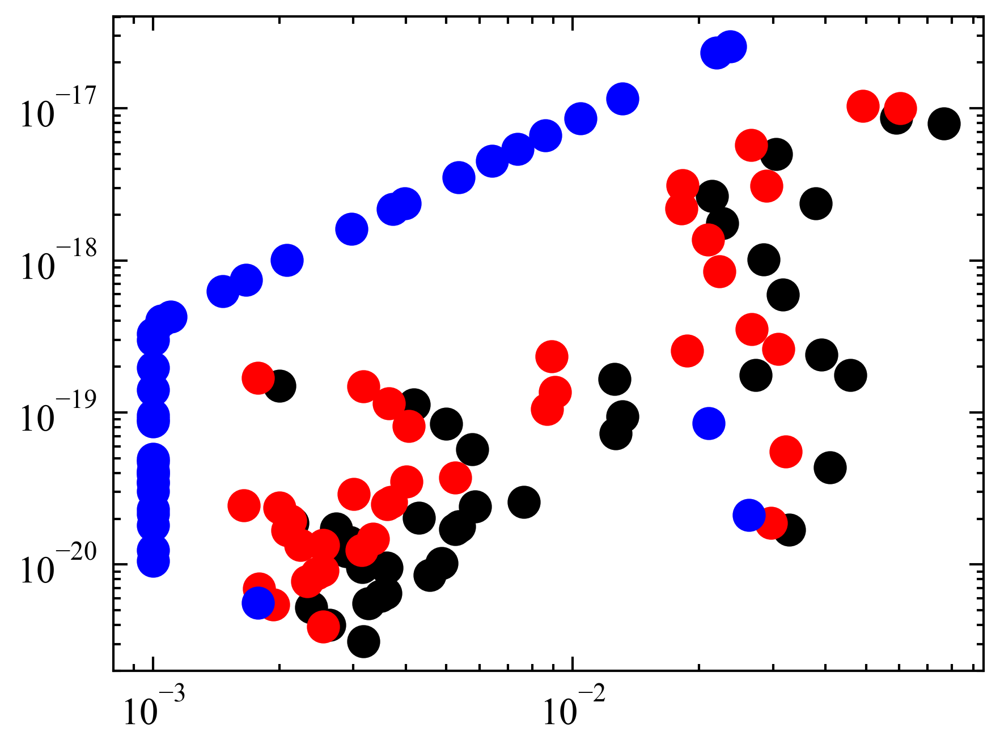

In [30]:
plt.scatter(data_for_ED_figure1[0,:],data_for_ED_figure1[1,:])
plt.scatter(data_for_ED_figure1[2,:],data_for_ED_figure1[3,:])
plt.scatter(data_for_ED_figure1[4,:],data_for_ED_figure1[5,:])
plt.xscale('log')
plt.yscale('log')
plt.show()

# 4. calculating accreted using 
### (1.1)Phenom( Li21 ) , part 1 for 12dns&27ns-(wd,ms,null)

In [29]:
def li_acc_m(p_eq):
    """
    calculate an accreted mass given an equilibrium period using the method in Li, Z.W., and et. al., 2021
    we fit the open circles in Figure 4. in arXiv:2108.02554v1, and obtain parameters: a = 0.3, b=-0.5.
    paramaters:
    -----
    p_eq: the period at equilibrium state, unit: s
    -----
    return :
    the accreted mass, unit: Solar mass
    
    """
    a=0.3
    b=-0.5
    return a*(p_eq*1000)**b

def tauris_acc_m(p_eq):
    """
    calculate an accreted mass given an equilibrium period
    using an initial mass of 1.4 M_Sun
    see https://arxiv.org/abs/1206.1862  Eq.14
    paramaters:
    -----
    p_eq: the period at equilibrium state, unit: s
    -----
    return :
    the accreted mass, unit: Solar mass
    """
    return 0.22*(1.4**(1/3))/(p_eq*1000)**(4/3)

def errf(p_eq):
    """
    calculate the 1-sigma error for Li21
    the 1-sigma is defined as 1/3 times of the difference between Tauris12  and the best fitted line in Li21
    -----
    p_eq: the period at equilibrium state, unit: s
    -----
    return :
    the errors of the accreted mass, unit: Solar mass
    
    """
    return (li_acc_m(p_eq)-tauris_acc_m(p_eq))/3


# get mean accreted mass
delta_m_li=np.zeros(nu*ns)
delta_m_li=li_acc_m(pran)

delta_m_birth_ran=np.zeros(ns*nu)
delta_m_birth_ran=np.random.normal(delta_m_li,errf(pran),ns*nu)

## load txt data of DNS , (39 modified pdot + 14 observed pdot)53 recycle mass data to slow  

In [30]:
#observed dns mass load from txt files
dns_name_ls=dns_mass_tables['Pname'][0:13]
dns_txt_name=list()
for i in range(13):
    d_c_n='{}.txt'.format(dns_name_ls[i])
    dns_txt_name.append(d_c_n)

In [32]:
dns_mr_obs=np.zeros(12*ns)
dns_ms_obs=np.zeros(13*ns)
nswd_m_obs=np.zeros(27*ns)
phenom_li21=np.zeros(39*ns)
for i in range(12):
    dns_mr_obs[i*ns:(i+1)*ns] = np.loadtxt(parent_dir_path+'/NSmassData/DNS/'+dns_txt_name[i],skiprows=1,delimiter=',')[:,0]
for i in range(13):
    dns_ms_obs[i*ns:(i+1)*ns] = np.loadtxt(parent_dir_path+'/NSmassData/DNS/'+dns_txt_name[i],skiprows=1,delimiter=',')[:,1]
for i in range(27):
    nswd_m_obs[i*ns:(i+1)*ns] = np.random.normal( nswd_mass_tables['mNS'][i], nswd_mass_tables['mNSerror'][i],ns )

phenom_li21= np.concatenate((dns_mr_obs, nswd_m_obs)) -  delta_m_birth_ran
np.savetxt('phenom_mr_modify_n39.txt',phenom_li21)

# load 53 mr obs (12 mr from dns, 27 mr from ns-wd, 14 mr from LMXB)

In [33]:
ns=10000
nswdxb_mr14_obs=np.zeros(14*ns)
for i in range(14):
    nswdxb_mr14_obs[i*ns:(i+1)*ns]=np.random.normal(nswd_mass_tables['mNS'][27+i],nswd_mass_tables['mNSerror'][27+i] ,ns)
mr_obs_53=np.concatenate((dns_mr_obs, nswd_m_obs,nswdxb_mr14_obs))
np.savetxt('mr_obs_53.txt',mr_obs_53)

### (2.1) Analytical , part 1 for 12dns&27ns-(wd,ms,null)

In [35]:
import matplotlib.pyplot as plt
import math
from scipy.stats import loguniform
import numpy as np
import pandas as pd
import astropy
import scipy
from scipy import interpolate 
import astropy.units as unit
import astropy.constants as const

ap4eos=pd.read_csv(parent_dir_path+'/NSmassData/ap4eos.csv',header=None)
ap4mr=np.zeros(( len(ap4eos[1][:])+20 ,2))
ap4mr[0:10,0]=np.linspace(2.212982,4,10)
ap4mr[0:10,1]=np.ones(10)*10.068513
ap4mr[10:28,0]=ap4eos[1][:].values
ap4mr[10:28,1]=ap4eos[0][:].values
ap4mr[28:,0]=np.linspace(0.1,0.983773,10)
ap4mr[28:,1]=np.ones(10)*11.471549

def intp_ap4eos_R_given_M(m):
    intp_ap4eos = interpolate.interp1d(ap4mr[:,0],ap4mr[:,1],fill_value="extrapolate")
    return intp_ap4eos(m)

def t_c(p,pdot):
    """
    callculate the characteristic age given p and pdot
    paramaters:
    -----
    p,pdot: i.e. period and period derivative; units= s , none
    return :
    the characteristic age; unit = Gyr
    
    """
    return ( ((p/(2*pdot))*unit.s).to(unit.Gyr) ).value #unit Gyr

def p_mid_sol(p,p_dot,Amax):
    """
    slove the intersection of two lines between the spin-up line and constatnt magnetic field lines to get period
    paramaters:
    ------
    input: p, p_dot, i.e. intrinsic period and period derivative
    return: 
    p_intsect, i.e. the period at the intersection between the spin-up line and the evolution trace of constant magnetic field
    """
    return (p_dot * p / Amax)**(3/7)

def p_dot_mid_sol(p,p_dot,Amax):
    """
    slove the intersection of two lines between the spin-up line and constatnt magnetic field lines to get pdot
    paramaters:
    ------
    input: p, p_dot, i.e. intrinsic period and period derivative
    return: 
    p_dot_intsect, i.e. the period derivative at the intersection between the spin-up line and the evolution trace of constant magnetic field
    """
    return ( (p_dot * p / (Amax))**(4/7) ) * Amax


def pdot_mag(p,B_mag):
    """
    get Pdot for a constant magnetic field 
    paramaters:
    -------
    p: the period, uni, s
    B_mag: the value of constant magnetic field, unit: G 
    -------
    return:
    p_dot
    
    """
    return (B_mag / 3.2e19)**2 / p
    

def pdot_year(p,year):
    """
    get Pdot for a constant age
    paramaters:
    -------
    p: the period, uni, s
    year: the value of the constant age, unit: yr
    -------
    return:
    p_dot
    
    """
    return 0.5*p/(year*365*24*60*60)

def delta_t(p,pdot,Amax):
    " note: the p pdot is the current value"
    return t_c(p,pdot) - t_c( p_mid_sol(p,pdot,Amax) ,p_dot_mid_sol(p,pdot,Amax) )

def spin_up_line_A(r, M, R, cosa, phi, wc):
    """
    # give the proportional ratio of the spin-up line 
    # Tauris style, also see my notebook
    
    # r:     r = Mdot / M_Eddinton, [0.01, 3]
    # M:     mass, [1.0, 3.0] 
    # R:     radius, [11, 13]
    # cosa: the Cosine of magnetic inclination angle in U[-1, 1], unit = None
    # phi:   the ratio of magnetospheric boundary, [0.5, 1.4]
    # wc:    criti fastness parameter, [0.25, 1]
    """
    coef1 = (2**(1/6) * const.G ** (5/3)) / (np.pi**(1/3) * const.c**3) * (8 * np.pi * const.c * const.m_p / const.sigma_T) 
    coef2 = 1 / 1.2 * unit.solMass**(2/3) / (0.237 * unit.km)
    coef3 = r * M**(2/3) * (2-cosa*cosa ) * phi**(-7/2) * wc**(7/3)
    coef4 = R * (1 + 4.2 * M / R + 90 * (M / R) ** 4)
    coef = coef1 * coef2 * coef3 / coef4
    return (coef.to(unit.s**(-4/3))).value

def i_mom(m,r):
    """
    calculate the moment of inertia
    paramaters:
    ----
    m: the mass of NS, unit= solar mass
    r: the radius of NS, unit= km
    ----
    return:
    the moment of inertia, unit = g * cm^2
    """
    return ( 0.237*m*r*r*(1+4.2*(m/r)+90*(m/r)**4 ) * ((1 * unit.solMass *unit.km**2 ).to(unit.g * unit.cm**2) ) ).value

def mag_dipole(m,r,p,pdot,cosa):
    """
    calculate the dipole magnetic file with unit (half)
    paramaters:
    ----
    m: the mass of NS, unit= solar mass
    r: the radius of NS, unit= km; the moment of inertia, unit = g * cm^2
    ----
    return:
    the dipole manetic field, unit = Gauss
    """
    return ( (((i_mom(m,r) *unit.g*unit.cm**2 ) * const.mu0*3 *const.c**3 / (8*np.pi**3* (r*unit.km)**6 ) )**0.5\
            * (1/(1-cosa**2))**0.5  * (p*unit.s*pdot)**0.5 ).to(unit.gauss) ).value *  0.5

def mag_combined(m,r,p,pdot,cosa):
    """
    calculate the combined magnetic file with unit (half)
    paramaters:
    ----
    m: the mass of NS, unit= solar mass
    r: the radius of NS, unit= km; the moment of inertia, unit = g * cm^2
    ----
    return:
    the combined manetic field, unit = Gauss
    """
    return ( (((i_mom(m,r) *unit.g*unit.cm**2 ) * const.mu0 *const.c**3 / (4*np.pi**3* (r*unit.km)**6 ) )**0.5\
            * (1/(2-cosa**2))**0.5  * (p*unit.s*pdot)**0.5 ).to(unit.gauss) ).value   *  0.5

def r_a(m,r,p,pdot,cosa,mdot):
    """
    calculate the Alfv´en radius defined as the location where the magnetic energy density
    paramaters:
    ---
    m: the mass of NS, unit= solar mass
    p: the period of pulsar, unit = s
    pdot: d p / d t, unit =None
    cosa: the Cosine of magnetic inclination angle in U[-1, 1], unit = None
    mdot: the ratio of  accretion, the odds of the Eddington accretion limit, unit = Medd
    ---
    return:
    the Alfv´en radius, unit = km
    """
    return 22 * (mag_combined(m,r,p,pdot,cosa)/10**8)**(4/7) * (mdot/0.1)**(-2/7)*(m/1.4)**(-5/7)

def dm_given_pmin(pmin, m,r,p,pdot,cosa,mdot,phi):
    """
    calculate the accreted mass given minimum period
    paramaters:
    ---
    pmin: the minimum period at equilibrum state, unit = s
    m: the mass of NS, unit= solar mass
    r: the radius of NS, unit = km
    p: the period of pulsar, unit = s
    pdot: d p / d t, unit =None
    cosa: the Cosine of magnetic inclination angle in U[-1, 1], unit = None
    mdot: the ratio of  accretion, the ratio of the Eddington accretion limit, unit = Medd
    psi: a parameter describing the size of magnetosphere, unit = None
    ---
    return:
    the accreted mass, unit = solar mass
    """
    return ( m*unit.solMass - ( (m*unit.solMass)**(3/2) - 3 * np.pi * 1.4*i_mom(m,r)*unit.g*unit.cm**2  / \
                             (const.G * phi * r_a(m,r,p,pdot,cosa,mdot)*unit.km )**0.5 * (1/ (pmin*unit.s )) )**(2/3) ).value

#####data test Pname	mr	mrerr	ms	mserr	
data_rec=data_a
na=2000000
ns=10000
samp_spa=np.zeros((na,5))
samp_spa[:,0]=loguniform.rvs(0.01,3,size=na) #mdot
#R AP4EOS
samp_spa[:,2]=np.random.uniform(-1,1,na)   #cosa
samp_spa[:,3]=np.random.uniform(0.5,1.4,na)#phi
samp_spa[:,4]=np.random.uniform(0.25,1,na) #wc

nu=len(data_rec['P0'])

samp_pick=np.zeros((nu*ns,7))

for i in range(nu):
    A_lim= data_rec['p1_birth_lim'][i] / data_rec['p0_birth_lim'][i]**(4/3)
    samp_ma=np.random.normal(data_rec['mr'][i],data_rec['mrerr'][i],na) #mass
    samp_spa[:,1]=intp_ap4eos_R_given_M(samp_ma) #R AP4EOS
    index_picka = (np.array( np.where( (np.array(samp_ma)/ samp_spa[:,1])  >= 0.07 ) ) )[0][:]
    samp_m = samp_ma[index_picka]
    samp_sp = samp_spa[index_picka]
    if A_lim < 1.1*10**(-15):
        # calculating the A
        samp_A=spin_up_line_A(samp_sp[:,0],samp_m[:], samp_sp[:,1], samp_sp[:,2], samp_sp[:,3], samp_sp[:,4])
        # picking up all A with [min, max_realdata_constrain]
        index_pick=(np.array( np.where( (( samp_A >= data_rec['P1'][i] / ( data_rec['P0'][i]**(4/3) ) ) &\
                                      (samp_A <= A_lim ) ) ) ) )[0][:]
        # pick up ns sample from all picked up A
        picked_v=np.random.choice(index_pick, size=ns, replace=False)
        # save the picked ns number data
        samp_pick[i*ns:(i+1)*ns,0]=samp_m[picked_v]
        samp_pick[i*ns:(i+1)*ns,1:-1]=samp_sp[picked_v,:]
        samp_pick[i*ns:(i+1)*ns,6] = samp_A[picked_v]
        #print(delta_t(data_rec['P0'][i],data_rec['P1'][i],np.max(samp_pick[i*ns:(i+1)*ns,6])),len(index_pick))
    else:
        # calculating the A
        samp_A=spin_up_line_A(samp_sp[:,0],samp_m[:], samp_sp[:,1], samp_sp[:,2], samp_sp[:,3], samp_sp[:,4])
        # picking up all A with [min, max_realdata_constrain]
        index_pick=(np.array( np.where( ( samp_A >= data_rec['P1'][i] / ( data_rec['P0'][i]**(4/3) ) ) & \
                                       (samp_A <= (1.1)*1e-15) ) ) )[0][:]
        # pick up ns sample from all picked up A
        picked_v=np.random.choice(index_pick, size=ns, replace=False)
        # save the picked ns number data
        samp_pick[i*ns:(i+1)*ns,0]=samp_m[picked_v]
        samp_pick[i*ns:(i+1)*ns,1:-1]=samp_sp[picked_v,:]
        samp_pick[i*ns:(i+1)*ns,6] = samp_A[picked_v]
        #print(delta_t(data_rec['P0'][i],data_rec['P1'][i],np.max(samp_pick[i*ns:(i+1)*ns,6])),len(index_pick))

    
#samp_pick[0*ns:1*ns,:] #0m  1#mdot 2#R  3#cosa  4#phi  5#wc 6#samp_A
ppdot_ran_samp=np.zeros((ns*nu,4))
for i in range(nu):
    ppdot_ran_samp[i*ns:(i+1)*ns,0] = p_mid_sol(data_rec['P0'][i],data_rec['P1'][i],samp_pick[i*ns:(i+1)*ns,6])
    ppdot_ran_samp[i*ns:(i+1)*ns,1] = p_dot_mid_sol(data_rec['P0'][i],data_rec['P1'][i],samp_pick[i*ns:(i+1)*ns,6])
    ppdot_ran_samp[i*ns:(i+1)*ns,2] = np.ones(ns) * data_rec['P0'][i]
    ppdot_ran_samp[i*ns:(i+1)*ns,3] = np.ones(ns) * data_rec['P1'][i]
    
#0m  1#mdot 2#R  3#cosa  4#phi  5#wc 6#samp_A 7#p_ran 8#pdot_ran  9#p0_obs 10#p1_int
samp_temp=np.concatenate( (samp_pick, ppdot_ran_samp),axis=1)
dm_ran=dm_given_pmin(samp_temp[:,7], samp_temp[:,0] , samp_temp[:,2], samp_temp[:,9] ,\
              samp_temp[:,10],samp_temp[:,3],samp_temp[:,1],samp_temp[:,4])
m_birth_ran=samp_temp[:,0]-dm_ran
samp_all=np.zeros((ns*nu,13))
samp_all[:,0:11]=samp_temp
samp_all[:,11]=dm_ran
samp_all[:,12]=m_birth_ran
spin_samp_datas=pd.DataFrame(samp_all,columns=['m','mdot','R','cosa','phi','wc', 'samp_A', 'p_ran', 'pdot_ran', \
                                              'p0_obs', 'pdot_int','dm_ran','m_birth_ran'])

np.savetxt('ana_mr_39.txt',spin_samp_datas['m_birth_ran'])
np.savetxt('ana_pran_39.txt',spin_samp_datas['p_ran'])

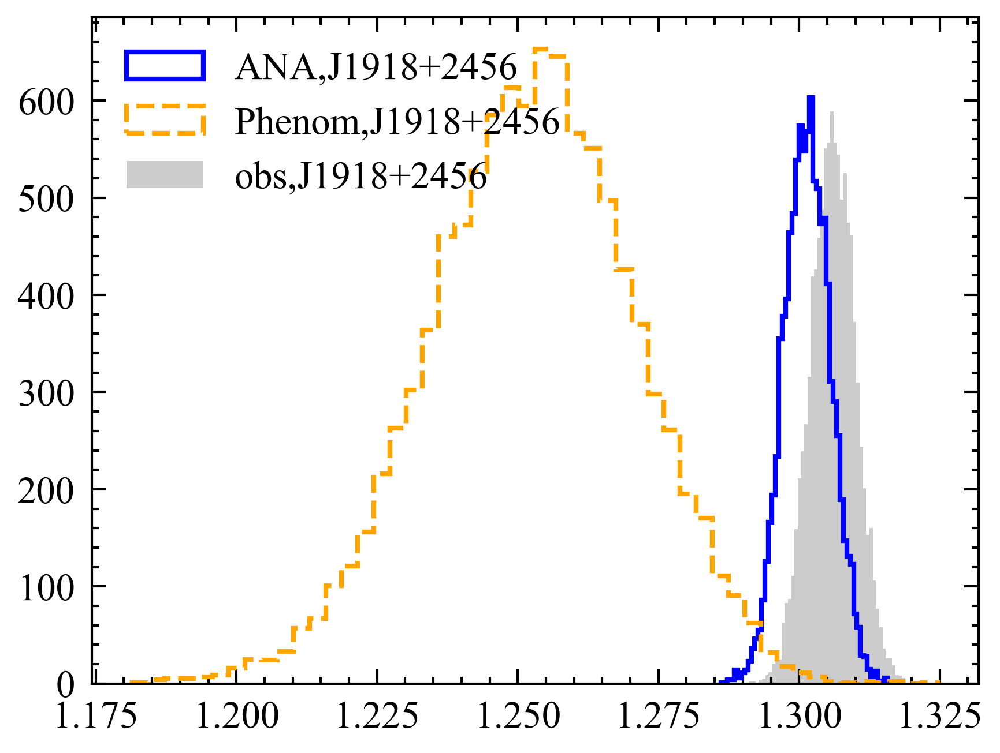

In [36]:
i=1
j1918_mr=np.random.normal(1.306,0.004,ns )
plt.hist(spin_samp_datas['m_birth_ran'][i*ns:(i+1)*ns],histtype='step',bins=50,color='blue',label='ANA,J1918+2456');
plt.hist(phenom_li21[i*ns:(i+1)*ns],histtype='step',bins=50,color='orange',label='Phenom,J1918+2456');
plt.hist(j1918_mr,histtype='bar',bins=50,color='grey',alpha=0.4,label='obs,J1918+2456');
plt.legend()

## check whether the results obtained are correct using figures

In [37]:
#pick up part of data
spin_samp_data=spin_samp_datas[::10]

/tmp/ipykernel_386472/554521657.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=True, which='major',linestyle='--',lw=0.2,alpha=0.5)



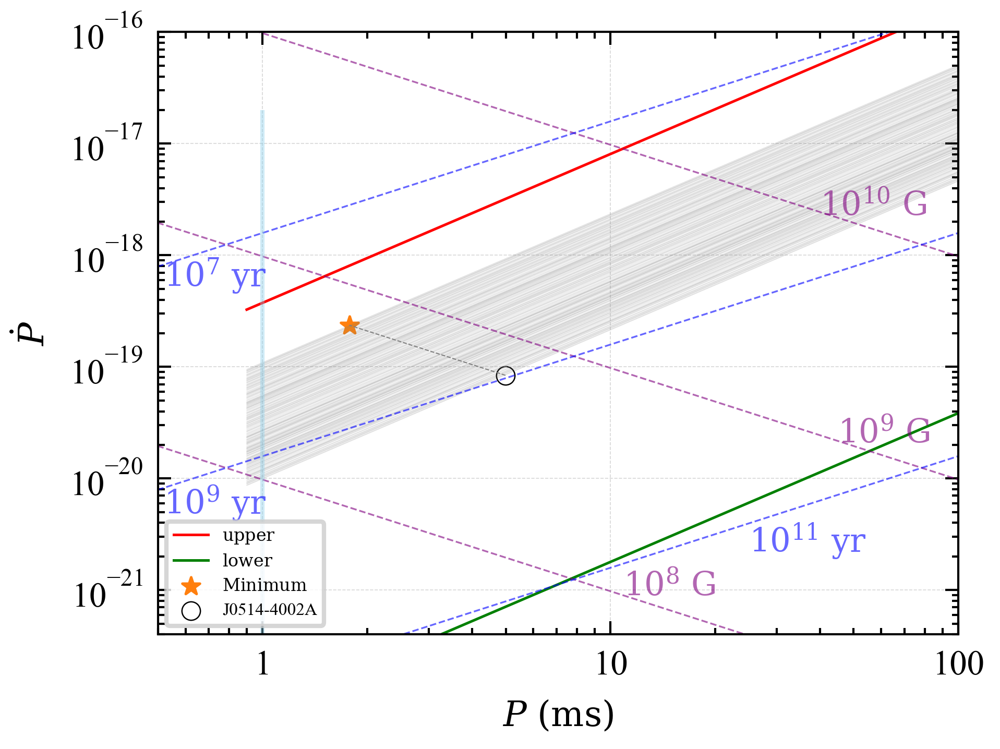

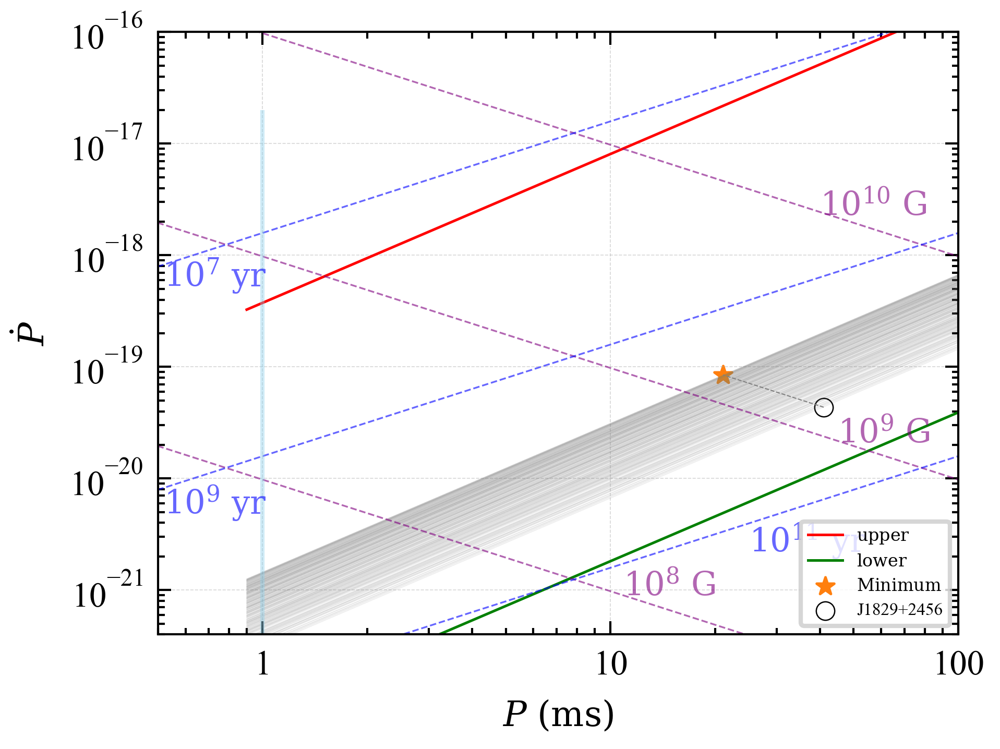

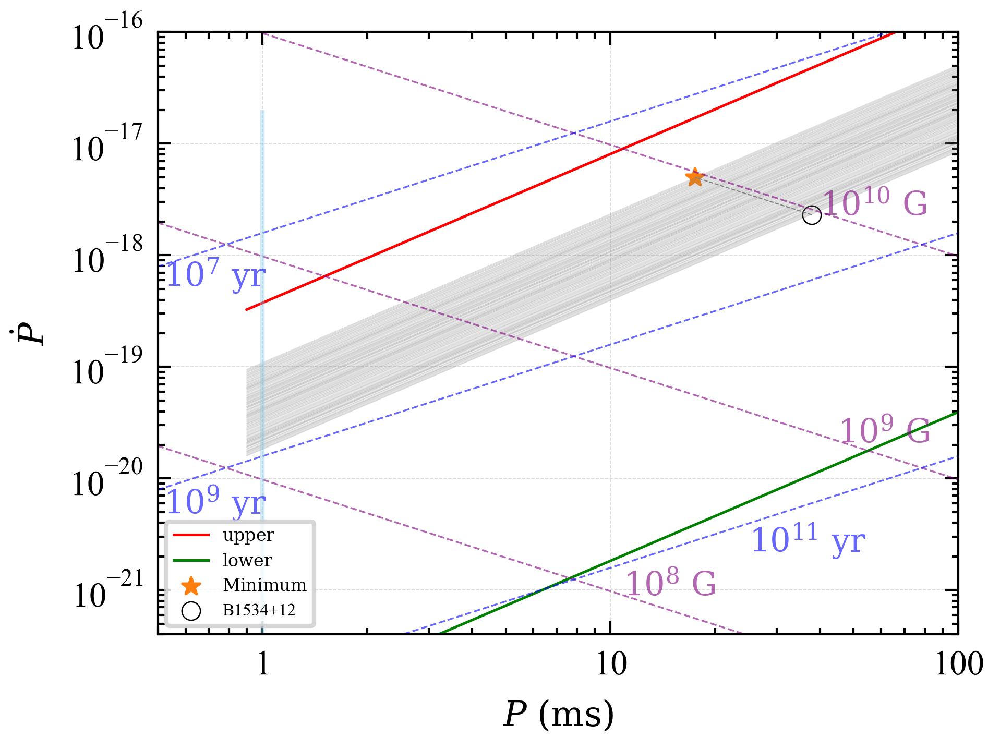

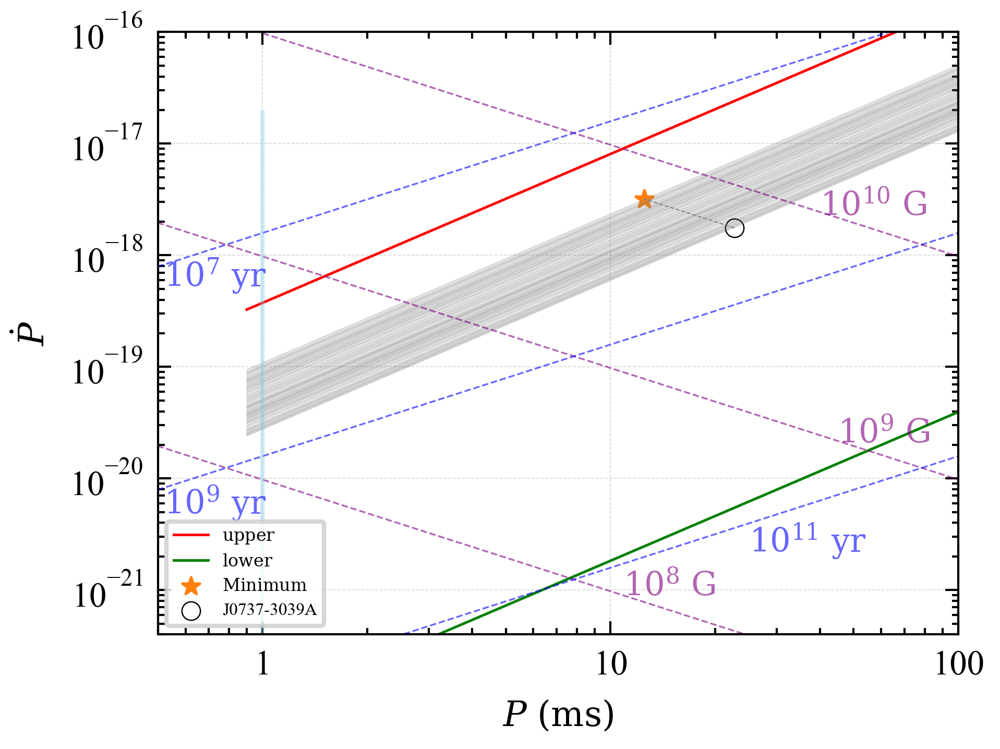

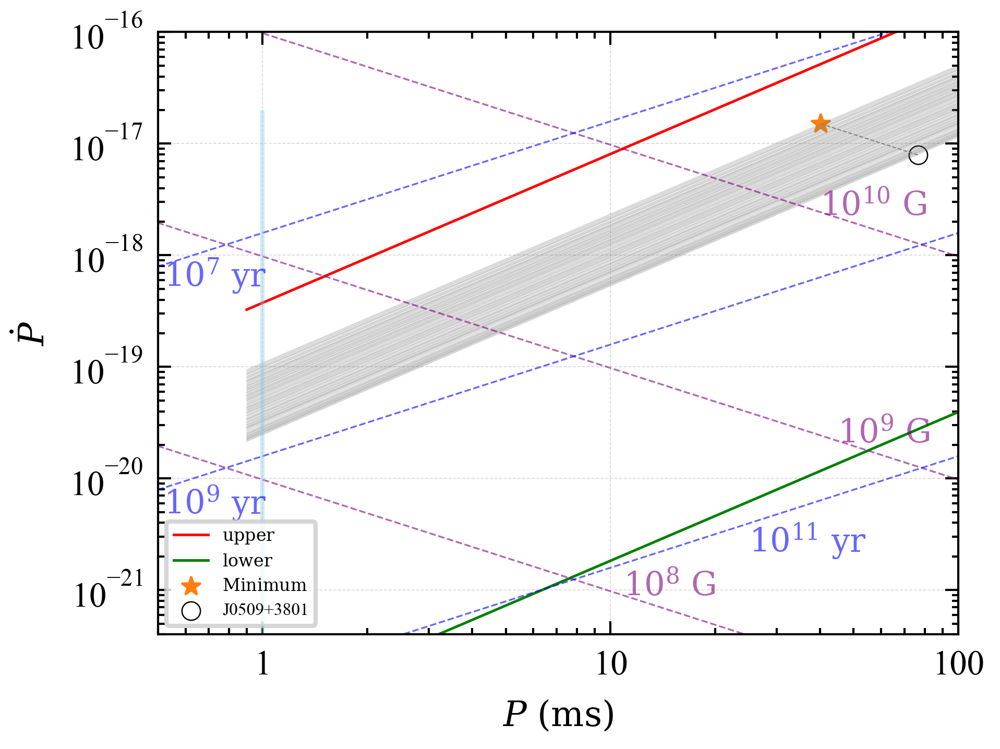

...

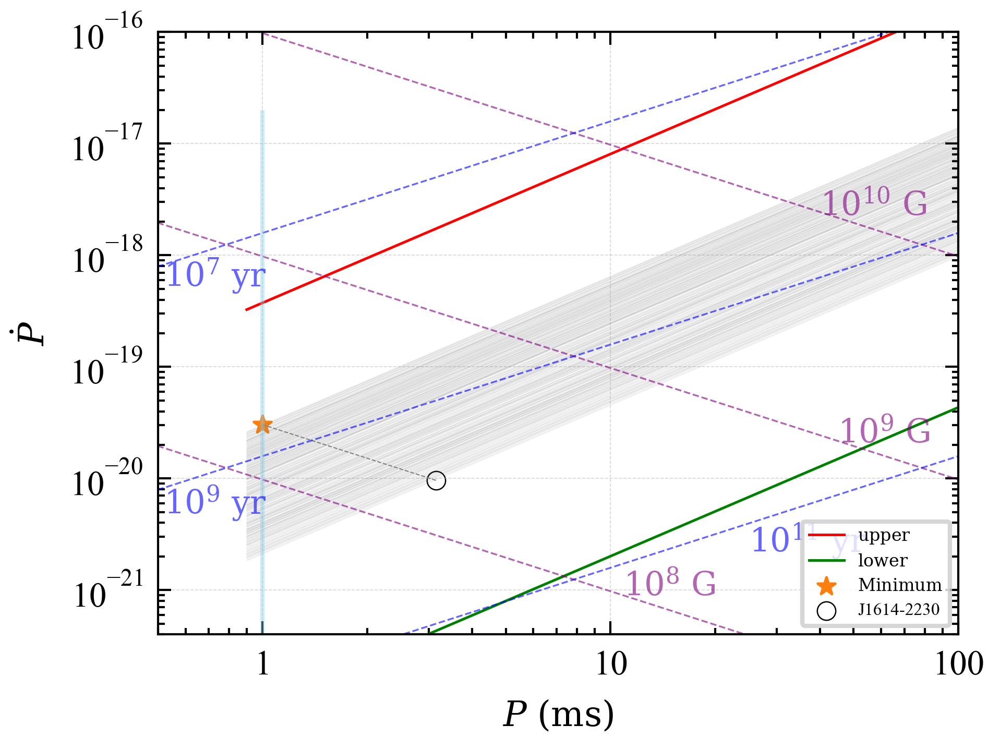

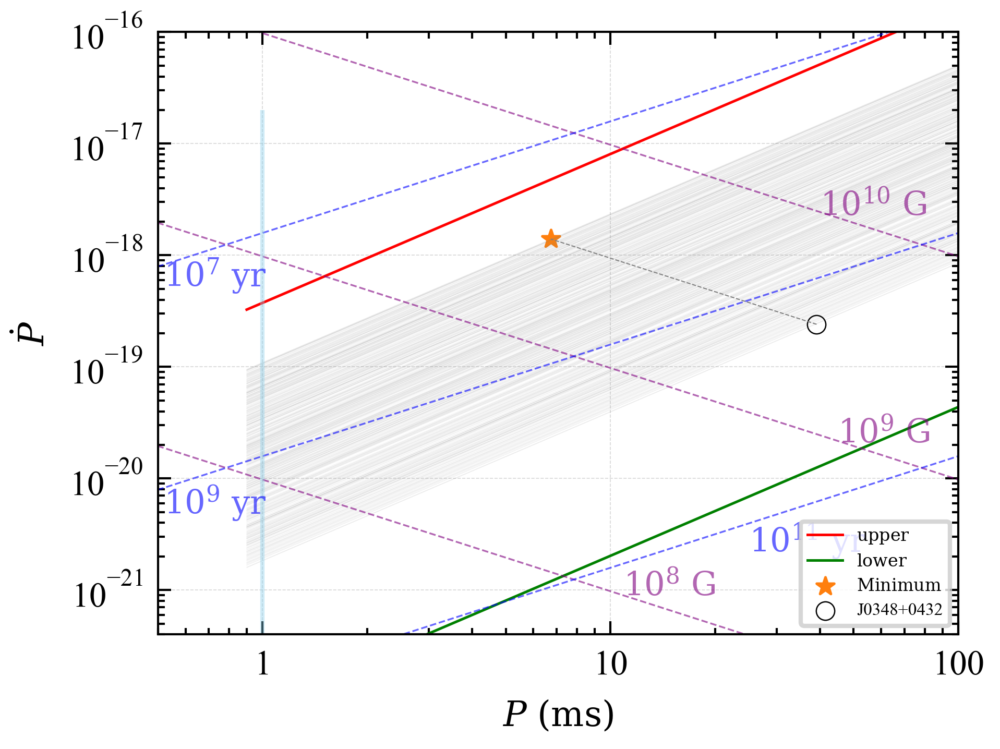

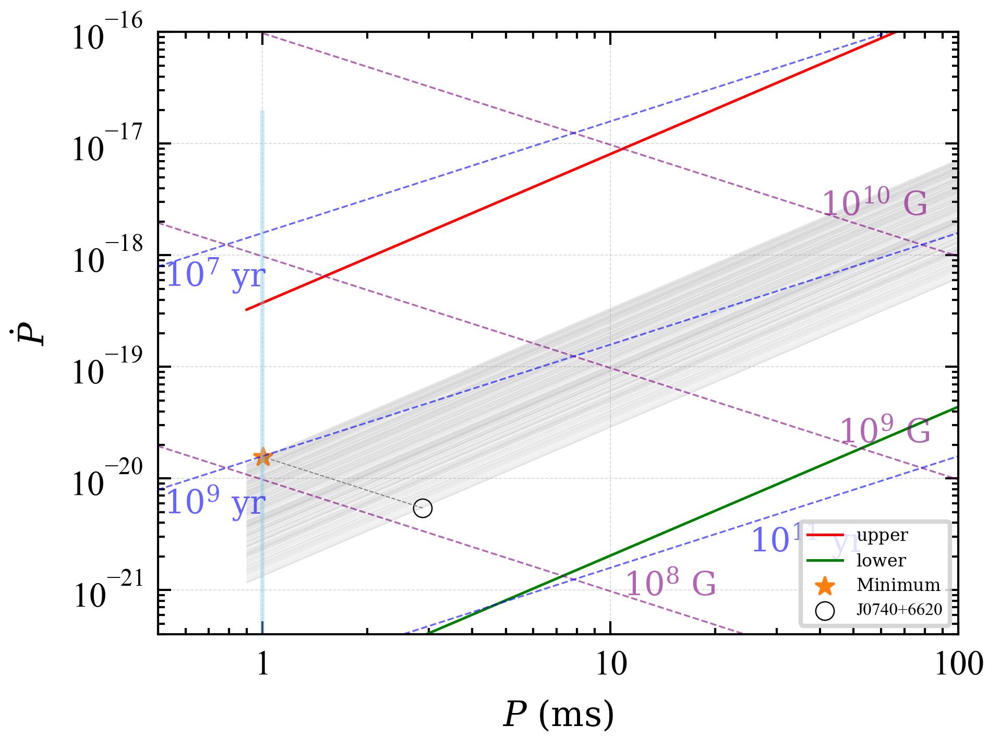

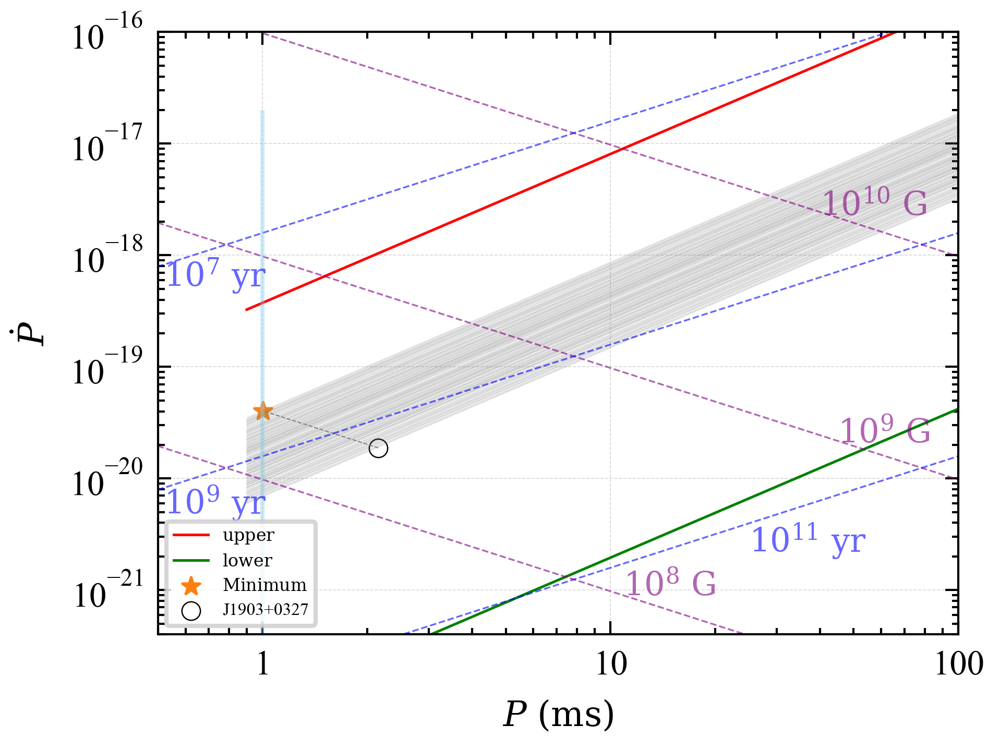

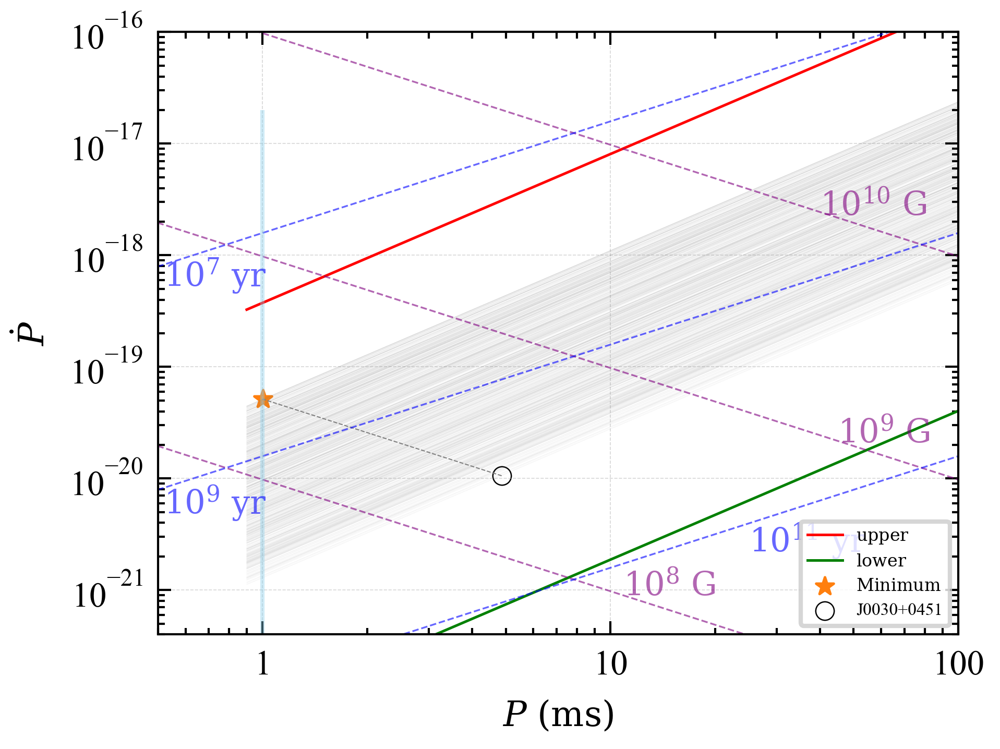

In [38]:
xx=np.linspace(0.0009,0.15,1000)
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
plt.style.use(['science','ieee','no-latex'])
p_arr=np.linspace(0.0001,20,10000)
p=np.linspace(0.0001,20,10000)
fs=7.5
ybeg=0.001
al=0.6
ms=18

ns_pick=1000

for i in range(39):
        plt.figure(i)
        plt.grid(b=True, which='major',linestyle='--',lw=0.2,alpha=0.5)
        #plot all possiable spin_up line
        for j in range(ns_pick):
            plt.plot(xx, spin_samp_data['samp_A'].iloc[i*ns_pick+j]*xx**(4/3), ls='-',lw=0.1,color='grey',alpha=0.05  )

        # spin-up line
        plt.plot(xx, (3.57+0.18)*1e-15*xx**(4/3),ls='-',lw=0.6,color='r',label=r'$\rm upper$') #upper

        #r, M, R, cosa, phi, wc #m mdot R cosa phi wc samp_A p_ran pdot_ran p0_obs pdot_int dm_ran m_birth_ran
        plt.plot(xx, spin_up_line_A(0.01 , data_rec['mr'][i] , (11.9+0.85), 1 ,1 , 0.25  )*xx**(4/3),ls='-',lw=0.6,color='green',label=r'$\rm lower$') #lower

        # minimum P and Pdot
        min_index=np.argmin(spin_samp_data['p_ran'][i*ns_pick:(i+1)*ns_pick])
        plt.scatter(spin_samp_data['p_ran'].iloc[i*ns_pick+min_index], spin_samp_data['pdot_ran'].iloc[i*ns_pick+min_index],marker='*',facecolor='#ff7f0e',
                edgecolors='#ff7f0e',lw=0.6,s=ms,label=r'$\rm{Minimum}$')

        # evolution trace
        plt.plot([data_rec['P0'][i],data_rec['p0_birth_lim'][i]],[data_rec['P1'][i],data_rec['p1_birth_lim'][i]],
                 linewidth=0.25,ls='--',color='grey',alpha=1)

        # observed, intrinsic and average value of (P, Pdot)
        plt.scatter(data_rec['P0'][i],data_rec['P1'][i],marker='o',facecolor='white',edgecolors='k',lw=0.3,s=ms,label=r'{}'.format(data_rec['Pname'][i]))

        # lines for constant magnetic field
        plt.plot(p,pdot_mag(p,10**8),color='purple',ls='--',lw=0.4,alpha=al)
        plt.plot(p,pdot_mag(p,10**9),color='purple',ls='--',lw=0.4,alpha=al)
        plt.plot(p,pdot_mag(p,10**10),color='purple',ls='--',lw=0.4,alpha=al)
        plt.text(10.9*10**(-3), 0.9*10**(-21), r'$\rm{10^{8} \,\, G}$', fontsize=fs, color='purple',alpha=al)
        plt.text(4.5*10**(-2), 2.1*10**(-20), r'$\rm{10^{9} \,\, G}$', fontsize=fs, color='purple',alpha=al)
        plt.text(4*10**(-2), 2.3*10**(-18), r'$\rm{10^{10} \,\, G}$', fontsize=fs, color='purple',alpha=al)

        # lines for constant age
        plt.plot(p,pdot_year(p,10**11),color='blue',ls='--',lw=0.4,alpha=al)
        plt.plot(p,pdot_year(p,10**9),color='blue',ls='--',lw=0.4,alpha=al)
        plt.plot(p,pdot_year(p,10**7),color='blue',ls='--',lw=0.4,alpha=al)
        plt.text(0.025, 2.2*10**(-21), r'$\rm{10^{11} \,\, yr}$', fontsize=fs, color='blue',alpha=al)
        plt.text(5.2*10**(-4), 4.8*10**(-21), r'$\rm{10^{9} \,\, yr}$', fontsize=fs, color='blue',alpha=al)
        plt.text(5.2*10**(-4), 5.3*10**(-19), r'$\rm{10^{7} \,\, yr}$', fontsize=fs, color='blue',alpha=al)

        # the minimum cut of P (1 ms)
        plt.vlines(0.001,10**(-22),2*10**(-17),color='skyblue',alpha=0.4)

        plt.xscale('log')
        plt.yscale('log')

        plt.xticks([1.e-5, 1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e+0, 1.e+1],['0.01','0.1','1','10','100','1000','10000'])
        plt.xlim([5.e-4,1.e-1])
        plt.ylim([4*10**(-22),10*10**(-17)])
        plt.legend(frameon=True,fontsize=4)
        plt.xlabel(r'$P\,\,(\rm{ms})$')
        plt.ylabel(r'$\dot{P}$')
        plt.show()

### (1.2)Phenom( $\Delta$ m=0.3p^-1/2 ) , part 2 (14 mr) for 6 redback+ 6black widow + LMXB using p1_int=p1_obs


In [39]:
phenom_mr_red_black_n14=np.zeros(14*ns)
for i in range(14):
    phenom_mr_red_black_n14[i*ns:(i+1)*ns] = np.random.normal(nswd_mass_tables['mNS'][27+i],nswd_mass_tables['mNSerror'][27+i] ,ns)\
                                              -np.ones(ns)*0.3*(nswd_mass_tables['P0'][27+i]*1000)**(-0.5)
np.savetxt('phenom_mr_red_black_n14.txt',phenom_mr_red_black_n14)

### (2.2) Analytical ($\Delta$ m=0.2p^-1),  part 2  (14 mr) for 6 redback+ 6black widow + LMXB using p1_int=p1_obs

In [40]:
ana_mr_red_black_n14=np.zeros(14*ns)
for i in range(14):
    ana_mr_red_black_n14[i*ns:(i+1)*ns] = np.random.normal(nswd_mass_tables['mNS'][27+i],nswd_mass_tables['mNSerror'][27+i] ,ns)\
                                              -np.ones(ns)*0.2*(nswd_mass_tables['P0'][27+i]*1000)**(-1)
np.savetxt('ana_mr_red_black_n14.txt',ana_mr_red_black_n14)

## 34 slow ns mass: 13 dns companions, 16 ns in excel sheet2, 2GW companions, 3 ns in GW ns-bh

In [42]:
nswd_df1  = pd.read_excel(nswd_excel_name,sheet_name=nswd_sheet_names[1]) 
nshmxb_mass_tables=nswd_df1[[ 'PSRName','mNS','mNSerror','mc','P0','P1','Pb','e','yn' ]]
nshmxb_mass_tables

,PSRName,mNS,mNSerror,mc,P0,P1,Pb,e,yn
0,J1141-6545,1.27,0.01,1.02,0.393898,4.294683e-15,0.197651,0.171884,0
1,J2305+4707,1.38,0.07,1.26,1.066371,5.690900e-16,12.339540,0.658369,0
2,LAMOST J1123,1.24,0.03,0.61,NaN,NaN,0.273835,NaN,0
3,J0045-7319,1.58,0.34,10.00,0.926276,4.463200e-15,51.169451,0.807949,0
4,4U 1538-522,1.02,0.17,16.00,526.800000,0.000000e+00,3.728414,NaN,0
5,SMC X-1,1.21,0.12,18.00,0.710000,0.000000e+00,3.891923,NaN,0
6,XTE J1855-026,1.41,0.24,21.00,360.700000,0.000000e+00,6.074150,NaN,0
7,Cen X-3,1.57,0.16,24.00,4.800000,0.000000e+00,2.087041,NaN,0
8,LMC X-4,1.57,0.11,18.00,13.500000,0.000000e+00,1.408379,NaN,0
9,SAX J1802.7-2017,1.57,0.25,22.00,139.600000,0.000000e+00,4.569700,NaN,0


In [43]:
dns_ms_13=dns_ms_obs
ns_hmxb_16=np.zeros(16*ns)
for i in range(16):
    ns_hmxb_16[i*ns:(i+1)*ns] = np.random.normal( nshmxb_mass_tables['mNS'][i], nshmxb_mass_tables['mNSerror'][i], ns )

In [46]:
GW200115_mass_post=np.loadtxt(parent_dir_path+'/NSmassData/gw_ns_mass/gw_post_GW200115_042309_posterior.txt')[:,1]
GW200115_ms=GW200115_mass_post[::4]
GW200105_mass_post=np.loadtxt(parent_dir_path+'/NSmassData/gw_ns_mass/gw_post_GW200105_162426_posterior.txt')[:,1]
GW200105_ms=GW200105_mass_post[::4]
GW191219_mass_post=np.loadtxt(parent_dir_path+'/NSmassData/gw_ns_mass/gw_post_GW191219_163120_posterior.txt')[:,1]
GW191219_ms=GW191219_mass_post[::4]
ns_gw_nsbh_ms_3=np.zeros(3*ns)
ns_gw_nsbh_ms_3[0*ns:1*ns]=GW200115_ms
ns_gw_nsbh_ms_3[1*ns:2*ns]=GW200105_ms
ns_gw_nsbh_ms_3[2*ns:3*ns]=GW191219_ms

In [47]:
GW190425_NSNS_astrospin=np.loadtxt(parent_dir_path+'/NSmassData/gw_ns_mass/GW190425_PhenomPv2_postsamp_astrospin_all.txt',skiprows=1)[:40000,0:2]
GW170817_NSNS_astrospin=np.loadtxt(parent_dir_path+'/NSmassData/gw_ns_mass/GW170817_PhenomPv2_postsamp_astrospin_all.txt',skiprows=1)[:40000,0:2]
GW190425_NSNS=GW190425_NSNS_astrospin[::4,:]
GW170817_NSNS=GW170817_NSNS_astrospin[::4,:]
nsns_gw_ms_2 = np.zeros(2*ns  )
nsns_gw_ms_2[0*ns:1*ns]=GW190425_NSNS[:,1]
nsns_gw_ms_2[1*ns:2*ns]=GW170817_NSNS[:,1]

In [48]:
ms_34=np.zeros(34*ns)
ms_34[0*ns:13*ns]=dns_ms_13
ms_34[13*ns:29*ns]=ns_hmxb_16
ms_34[29*ns:32*ns]=ns_gw_nsbh_ms_3
ms_34[32*ns:34*ns]=nsns_gw_ms_2

In [49]:
np.savetxt('ms_34.txt',ms_34)

# combining the corrected neutron star mass accounting for the effects of accretion by Analytical method and slow NS mass(39-calculated p1_int+14-p1_obs+34_slow)

In [160]:
ana_corr_mr_39=np.loadtxt('ana_mr_39.txt')
ana_corr_p1obs_14=np.loadtxt('ana_mr_red_black_n14.txt')
ms_34=np.loadtxt('ms_34.txt')
ana_corrected_mrms_87=np.concatenate((ana_corr_mr_39,ana_corr_p1obs_14,ms_34))
np.savetxt('ana_corrected_mrms_87.txt',ana_corrected_mrms_87)

# combining the corrected neutron star mass accounting for the effects of accretion by Analytical(39-calculated p1_int+14-p1_obs) for m_r corracted mass

In [191]:
ana_corrected_mr_53=abs(np.concatenate((ana_corr_mr_39,ana_corr_p1obs_14)))
np.savetxt('ana_corrected_mr_53.txt',(ana_corrected_mr_53) )

# combining the corrected neutron star mass accounting for the effects of accretion by Phenom method and slow NS mass(39-calculated p1_int+14-p1_obs+34_slow)

In [161]:
phe_corr_mr_39=np.loadtxt('phenom_mr_modify_n39.txt')
phe_corr_p1obs_14=np.loadtxt('phenom_mr_red_black_n14.txt')
ms_34=np.loadtxt('ms_34.txt')
phe_corrected_mrms_87=np.concatenate((phe_corr_mr_39,phe_corr_p1obs_14,ms_34))
np.savetxt('phe_corrected_mrms_87.txt',phe_corrected_mrms_87)

# combining the corrected neutron star mass accounting for the effects of accretion by phenom(39-calculated p1_int+14-p1_obs) for m_r corrected mass

In [170]:
phe_corrected_mr_53=np.concatenate((phe_corr_mr_39,phe_corr_p1obs_14))
np.savetxt('phe_corrected_mr_53.txt',phe_corrected_mr_53)

# radio pulsar timing data

In [8]:
import numpy as np
ana_mr_tem=np.loadtxt('ana_mr_39.txt')
ana_mr_used=ana_mr_tem[:38*10000]

In [17]:
ms_34_temp=np.loadtxt('ms_34.txt')
ms_radio_p=np.zeros(16*10000)
i_index=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,16]
for i in range(16):
    ms_radio_p[i*10000:(i+1)*10000]=ms_34_temp[i_index[i]*10000:(i_index[i]+1)*10000]

In [26]:
ana_radio=np.concatenate(( ana_mr_used, ms_radio_p))

In [31]:
np.savetxt('ana_radio.txt',ana_radio[::2])